In [1]:
#from scipy import fft
from scipy import signal as sig
from scipy.fft import fft, fftfreq
from IPython.display import Audio
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import math
import wave
import numpy as np
import matplotlib.pyplot as plt
import sys
import os
import librosa, librosa.display
import IPython.display as ipd
from pandas.plotting import register_matplotlib_converters
register_matplotlib_converters()
import scipy.io.wavfile as wavfile
import scipy
import scipy.fftpack
import numpy as np
from matplotlib import pyplot as plt
import seaborn as sns
import plotly.graph_objs as go
import warnings
warnings.simplefilter('ignore')

In [2]:
# Testing Files present at Files\cough_wavs_sample

# Visualising audio signal in the time domain

In [3]:
def waveform_plot(file):
    audio_time_series, sr = librosa.load(file)
    plt.figure(figsize=(15, 3))
    librosa.display.waveplot(audio_time_series, alpha=0.5)
    plt.ylim((-1, 1))
    source = r'C:\Users\DELL\COV_Project\Files\cough_wavs_sample\cleaned_data\Positive'
    if source in file:
        name = file.replace(source + '/','')
    plt.title(name)

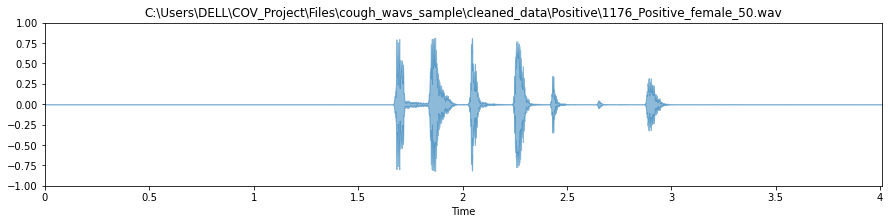

In [4]:
waveform_plot(r'C:\Users\DELL\COV_Project\Files\cough_wavs_sample\cleaned_data\Positive\1176_Positive_female_50.wav')

In [5]:
def custom_fft(y, fs):
    T = 1.0 / fs
    N = y.shape[0]
    yf = fft(y)
    xf = np.linspace(0.0, 1.0/(2.0*T), N//2)
    vals = 2.0/N * np.abs(yf[0:N//2])  
    return xf, vals

In [6]:
def plot_wave(file):
    demo_audio = file #shorter clip
    demo_clip, demo_sample_rate = librosa.load(demo_audio, sr=None)
    demo_xf, demo_vals = custom_fft(demo_clip, demo_sample_rate)

    trace = [go.Scatter(
    x=np.linspace(0, demo_sample_rate/len(demo_clip), len(demo_clip)), 
    y=demo_clip
    )]
    layout = go.Layout(
        title = 'Waveform <br><sup>Interactive</sup>',
        yaxis = dict(title='Amplitude'),
        xaxis = dict(title='Time'),
        )
    fig = go.Figure(data=trace, layout=layout)
    fig.show()
    
file = r'C:\Users\DELL\COV_Project\Files\cough_wavs_sample\cleaned_data\Positive\1041_Positive_male_39.wav'
plot_wave(file)

# Plotting FFT of single audio files

In [7]:
#Source: https://www.kaggle.com/himanshu007121/audio-analysis-and-augmentation-demo/

def plot_fft(file):
    demo_audio = file #shorter clip
    demo_clip, demo_sample_rate = librosa.load(demo_audio, sr=None)
    demo_xf, demo_vals = custom_fft(demo_clip, demo_sample_rate)

    trace = [go.Scatter(
        x=demo_xf, 
        y=demo_vals,
        line_color='deeppink'
    )]
    layout = go.Layout(
        title = 'Fast Fourier Transform (FFT) <br><sup>Interactive</sup>',
        yaxis = dict(title='Magnitude'),
        xaxis = dict(title='Frequency'),
        )
    fig = go.Figure(data=trace, layout=layout)
    fig.show()

file = r'C:\Users\DELL\COV_Project\Files\cough_wavs_sample\cleaned_data\Positive\1041_Positive_male_39.wav'
plot_fft(file)

# Extracting Frequency and Amplitude Values as Lists for each audio recording

### Method 1 -- Currently Used

In [8]:
# https://stackoverflow.com/questions/23377665/python-scipy-fft-wav-files --> Answer 2
def fft_new(file):
    fs_rate, signal = wavfile.read(file)
    #print ("Frequency sampling", fs_rate)
    l_audio = len(signal.shape)
    #print ("Channels", l_audio)
    if l_audio == 2:
        signal = signal.sum(axis=1) / 2
    #N = signal.shape[0]
    N = 20000
    #print ("Complete Samplings N", N)
    secs = N / float(fs_rate)
    #print ("secs", secs)
    Ts = 1.0/fs_rate # sampling interval in time
    #print ("Timestep between samples Ts", Ts)
    t = scipy.arange(0, secs, Ts) # time vector as scipy arange field / numpy.ndarray
    FFT = abs(fft(signal))
    FFT_side = FFT[range(N//2)] # one side FFT range
    freqs = scipy.fftpack.fftfreq(signal.size, t[1]-t[0])
    fft_freqs = np.array(freqs)
    freqs_side = freqs[range(N//2)] # one side frequency range
    fft_freqs_side = np.array(freqs_side)
#     p = plt.plot(freqs_side, abs(FFT_side), "b") # plotting the positive fft spectrum
#     plt.xlabel('Frequency (Hz)')
#     plt.ylabel('Magnitude')
#     plt.show()
    mag = abs(FFT_side)
    freq = freqs_side
    return freq, mag

In [9]:
file = r'C:\Users\DELL\COV_Project\Files\cough_wavs_sample\cleaned_data\Positive\1192_Positive_male_28.wav'
freq, mag = fft_new(file)

# Creating Dataframe using Max Amplitude in Each Frequency Bin

In [10]:
freq

array([0.00000000e+00, 1.77556818e-01, 3.55113636e-01, ...,
       1.77503551e+03, 1.77521307e+03, 1.77539063e+03])

In [11]:
mag

array([ 397362.        ,  129754.67945268,   34803.9926451 , ...,
       2278775.57641211, 4870834.18070193, 6823351.14934344])

In [12]:
def createSeries (series_list):
    series_list = pd.Series(series_list)  
    return series_list

frequencies = createSeries(freq) 
Amplitude = createSeries(mag)


data = {"frequencies": frequencies,
            "Amplitude": Amplitude}
df1 = pd.concat(data, axis = 1)
df1.head()

,frequencies,Amplitude
0,0.000000,397362.000000
1,0.177557,129754.679453
2,0.355114,34803.992645
3,0.532670,242914.596312
4,0.710227,106797.168212


In [13]:
df2 = df1[df1['frequencies']<1000]

In [14]:
df2.describe()

,frequencies,Amplitude
count,5632.000000,5.632000e+03
mean,499.911222,9.307115e+06
std,288.700762,9.583687e+06
min,0.000000,6.168204e+02
25%,249.955611,2.035401e+06
50%,499.911222,6.508850e+06
75%,749.866832,1.336098e+07
max,999.822443,7.743525e+07


In [15]:
squares1 = []
for i in range(51):
        squares1.append(i * 20)

cols = []
string = 'string'
for i in range(1000):
    if i % 20 == 0:
        string ='(' + str(i) + ',' + str(i+20) + ']'
        #Append in a list
        cols.append(string)

a = pd.cut(df2.frequencies,bins = squares1, labels = cols)
# a contains the respective bins for all frequency values in df1

In [16]:
#Now join a and df1 and groupby + percentile

In [17]:
type(a)

pandas.core.series.Series

In [18]:
type(df2.Amplitude)

pandas.core.series.Series

In [19]:
def createSeries (series_list):
  series_list = pd.Series(series_list) 
  return series_list

freq = a
amp = df2.Amplitude
data = {"freq": freq,
        "amp": amp}
df3 = pd.concat(data,
               axis = 1)
  
# show the dataframe
df3

,freq,amp
0,NaN,3.973620e+05
1,"(0,20]",1.297547e+05
2,"(0,20]",3.480399e+04
3,"(0,20]",2.429146e+05
4,"(0,20]",1.067972e+05
...,...,...
5627,"(980,1000]",1.516090e+06
5628,"(980,1000]",4.589862e+06
5629,"(980,1000]",2.916066e+06
5630,"(980,1000]",1.211027e+06


In [69]:
# 90th Percentile
def q75(x):
    return x.quantile(0.75)
def q90(x):
    return x.quantile(0.90)

def percentile(n):
    def percentile_(x):
        return np.percentile(x, n)
    percentile_.__name__ = 'percentile_%s' % n
    return percentile_



final_data_single_rec = df3.groupby(['freq']).agg({'amp': [percentile(95)]})

In [76]:
final_data_single_rec.head()

,amp
,percentile_95
freq,
"(0,20]",263850.651760
"(20,40]",278179.024944
"(40,60]",269001.513863
"(60,80]",505416.899245
"(80,100]",670777.578081


In [77]:
final_data_single_rec.columns

MultiIndex([('amp', 'percentile_95')],
           )

In [79]:
final_data_single_rec[('amp', 'percentile_95')]

freq
(0,20]        2.638507e+05
(20,40]       2.781790e+05
(40,60]       2.690015e+05
(60,80]       5.054169e+05
(80,100]      6.707776e+05
(100,120]     6.179939e+05
(120,140]     7.597518e+05
(140,160]     1.265893e+06
(160,180]     2.064337e+06
(180,200]     3.964047e+06
(200,220]     9.732567e+06
(220,240]     2.962097e+07
(240,260]     3.501303e+07
(260,280]     4.023219e+07
(280,300]     1.764209e+07
(300,320]     2.009738e+07
(320,340]     9.572075e+06
(340,360]     8.295823e+06
(360,380]     9.767624e+06
(380,400]     1.174761e+07
(400,420]     1.216763e+07
(420,440]     1.851306e+07
(440,460]     2.398256e+07
(460,480]     3.662264e+07
(480,500]     3.049148e+07
(500,520]     4.068334e+07
(520,540]     4.292296e+07
(540,560]     5.108778e+07
(560,580]     3.910316e+07
(580,600]     3.808751e+07
(600,620]     4.126607e+07
(620,640]     3.467434e+07
(640,660]     3.164257e+07
(660,680]     3.023999e+07
(680,700]     3.423548e+07
(700,720]     2.916488e+07
(720,740]     2.205319e

In [73]:
final_data_single_rec.xs('percentile_95', level='amp', axis=1)

KeyError: 'Level amp not found'

In [80]:
final_data_single_rec.columns = ['_'.join(col) for col in final_data_single_rec.columns.values]

In [81]:
final_data_single_rec.head()

,amp_percentile_95
freq,
"(0,20]",263850.651760
"(20,40]",278179.024944
"(40,60]",269001.513863
"(60,80]",505416.899245
"(80,100]",670777.578081


In [85]:
n = final_data_single_rec.to_csv(index=False)

In [87]:
test = pd.read_csv(n, sep='\r')
test

OSError: [Errno 22] Invalid argument: 'amp_percentile_95\r\n263850.6517599185\r\n278179.0249440609\r\n269001.51386344316\r\n505416.899245256\r\n670777.5780809377\r\n617993.8835654474\r\n759751.8049281738\r\n1265892.9403610243\r\n2064336.7452335188\r\n3964047.114863574\r\n9732566.970178304\r\n29620965.074097093\r\n35013033.83846896\r\n40232188.314881444\r\n17642090.12861204\r\n20097383.35478642\r\n9572074.878403448\r\n8295822.596534319\r\n9767623.503830386\r\n11747607.124421613\r\n12167625.36856507\r\n18513059.815651353\r\n23982555.63081343\r\n36622641.23292524\r\n30491480.28711038\r\n40683343.50867091\r\n42922963.40741899\r\n51087778.793563664\r\n39103158.425029956\r\n38087506.98231686\r\n41266066.10653956\r\n34674340.724935696\r\n31642571.35490125\r\n30239993.753468998\r\n34235484.94624176\r\n29164879.017810818\r\n22053190.453769945\r\n20793559.257291995\r\n16744937.000436159\r\n18321581.82090947\r\n13850260.193042805\r\n18541687.599466972\r\n11236039.709697692\r\n9098057.970169479\r\n8911067.967445584\r\n8440823.501859842\r\n11647838.425142916\r\n5346861.127926564\r\n4521609.404771633\r\n4685244.367758162\r\n'

In [82]:
final_data_single_rec.columns

Index(['amp_percentile_95'], dtype='object')

In [83]:
final_data_single_rec.loc[:,(final_data_single_rec.dtypes=='float64').values]

,amp_percentile_95
freq,
"(0,20]",2.638507e+05
"(20,40]",2.781790e+05
"(40,60]",2.690015e+05
"(60,80]",5.054169e+05
"(80,100]",6.707776e+05
"(100,120]",6.179939e+05
"(120,140]",7.597518e+05
"(140,160]",1.265893e+06
"(160,180]",2.064337e+06


In [66]:
v = final_data_single_rec['amp_percentile_95']

In [68]:
v

freq
(0,20]        2.638507e+05
(20,40]       2.781790e+05
(40,60]       2.690015e+05
(60,80]       5.054169e+05
(80,100]      6.707776e+05
(100,120]     6.179939e+05
(120,140]     7.597518e+05
(140,160]     1.265893e+06
(160,180]     2.064337e+06
(180,200]     3.964047e+06
(200,220]     9.732567e+06
(220,240]     2.962097e+07
(240,260]     3.501303e+07
(260,280]     4.023219e+07
(280,300]     1.764209e+07
(300,320]     2.009738e+07
(320,340]     9.572075e+06
(340,360]     8.295823e+06
(360,380]     9.767624e+06
(380,400]     1.174761e+07
(400,420]     1.216763e+07
(420,440]     1.851306e+07
(440,460]     2.398256e+07
(460,480]     3.662264e+07
(480,500]     3.049148e+07
(500,520]     4.068334e+07
(520,540]     4.292296e+07
(540,560]     5.108778e+07
(560,580]     3.910316e+07
(580,600]     3.808751e+07
(600,620]     4.126607e+07
(620,640]     3.467434e+07
(640,660]     3.164257e+07
(660,680]     3.023999e+07
(680,700]     3.423548e+07
(700,720]     2.916488e+07
(720,740]     2.205319e

In [67]:
type(v)

pandas.core.series.Series

In [65]:
final_data_single_rec.describe()

,amp_percentile_95
count,5.000000e+01
mean,1.822918e+07
std,1.445499e+07
min,2.638507e+05
25%,6.084101e+06
50%,1.529760e+07
75%,3.042861e+07
max,5.108778e+07


In [63]:
print(final_data_single_rec['amp_percentile_95'])

freq
(0,20]        2.638507e+05
(20,40]       2.781790e+05
(40,60]       2.690015e+05
(60,80]       5.054169e+05
(80,100]      6.707776e+05
(100,120]     6.179939e+05
(120,140]     7.597518e+05
(140,160]     1.265893e+06
(160,180]     2.064337e+06
(180,200]     3.964047e+06
(200,220]     9.732567e+06
(220,240]     2.962097e+07
(240,260]     3.501303e+07
(260,280]     4.023219e+07
(280,300]     1.764209e+07
(300,320]     2.009738e+07
(320,340]     9.572075e+06
(340,360]     8.295823e+06
(360,380]     9.767624e+06
(380,400]     1.174761e+07
(400,420]     1.216763e+07
(420,440]     1.851306e+07
(440,460]     2.398256e+07
(460,480]     3.662264e+07
(480,500]     3.049148e+07
(500,520]     4.068334e+07
(520,540]     4.292296e+07
(540,560]     5.108778e+07
(560,580]     3.910316e+07
(580,600]     3.808751e+07
(600,620]     4.126607e+07
(620,640]     3.467434e+07
(640,660]     3.164257e+07
(660,680]     3.023999e+07
(680,700]     3.423548e+07
(700,720]     2.916488e+07
(720,740]     2.205319e

In [22]:
a.head()

0       NaN
1    (0,20]
2    (0,20]
3    (0,20]
4    (0,20]
Name: frequencies, dtype: category
Categories (50, object): ['(0,20]' < '(20,40]' < '(40,60]' < '(60,80]' ... '(920,940]' < '(940,960]' < '(960,980]' < '(980,1000]']

In [23]:
squares1 = []
for i in range(51):
        squares1.append(i * 20)

In [24]:
squares1

[0,
 20,
 40,
 60,
 80,
 100,
 120,
 140,
 160,
 180,
 200,
 220,
 240,
 260,
 280,
 300,
 320,
 340,
 360,
 380,
 400,
 420,
 440,
 460,
 480,
 500,
 520,
 540,
 560,
 580,
 600,
 620,
 640,
 660,
 680,
 700,
 720,
 740,
 760,
 780,
 800,
 820,
 840,
 860,
 880,
 900,
 920,
 940,
 960,
 980,
 1000]

In [25]:
def createSeries (series_list):
    series_list = pd.Series(series_list)  
    return series_list

def freq_bin_vs_amp(frequency_list, amplitude_list):
    frequencies = createSeries(frequency_list) 
    Amplitude = createSeries(amplitude_list)
    
    # create a dictonary
    data = {"frequencies": frequencies,
            "Amplitude": Amplitude}
    df = pd.concat(data, axis = 1)
    #Create Bins
    squares = []
    # for i in range(11):
    #     squares.append(i * 100)
    for i in range(51):
        squares.append(i * 20)
    bins = squares
    df['binned_freq'] = pd.cut(df['frequencies'], bins)
    # Extract Maximum amplitude for that Bin
    # ---------------------------------------------------------------------------------------------
    # PROBLEM --> Soln: Use IQR 75%ile or Mode or any other metric
    # ---------------------------------------------------------------------------------------------
    # df = df[df['Amplitude']==df.groupby('binned_freq')['Amplitude'].transform('max')]
    # #df['amps'] =  df.groupby('binned_freq')['Amplitude']
    # df = df[['Amplitude', 'binned_freq']].reset_index(drop=True)
    
    def q90(x):
        return x.quantile(0.9)
    
    my_DataFrame.groupby(['AGGREGATE']).agg({'MY_COLUMN': [q50, q90, 'max']})





    return df, df['Amplitude'].tolist()

#Idea --> Append df['Amplitude'] to another dataframe

In [26]:
# Freq and amplitude dataframe --> discretizing the frequency column --> Group by + np.quantile (https://pandas.pydata.org/pandas-docs/version/0.17.0/generated/pandas.core.groupby.DataFrameGroupBy.quantile.html) 

In [27]:
cols = []
string = 'string'
for i in range(1000):
    if i % 20 == 0:
        string ='(' + str(i) + ',' + str(i+20) + ']'
        #Append in a list
        cols.append(string)
print(cols)

['(0,20]', '(20,40]', '(40,60]', '(60,80]', '(80,100]', '(100,120]', '(120,140]', '(140,160]', '(160,180]', '(180,200]', '(200,220]', '(220,240]', '(240,260]', '(260,280]', '(280,300]', '(300,320]', '(320,340]', '(340,360]', '(360,380]', '(380,400]', '(400,420]', '(420,440]', '(440,460]', '(460,480]', '(480,500]', '(500,520]', '(520,540]', '(540,560]', '(560,580]', '(580,600]', '(600,620]', '(620,640]', '(640,660]', '(660,680]', '(680,700]', '(700,720]', '(720,740]', '(740,760]', '(760,780]', '(780,800]', '(800,820]', '(820,840]', '(840,860]', '(860,880]', '(880,900]', '(900,920]', '(920,940]', '(940,960]', '(960,980]', '(980,1000]']


In [28]:
#Create Dataframe for appending df['Amplitude']
final_data = pd.DataFrame(columns=cols)
final_data_length = len(final_data)
#final_data.loc[final_data_length] = amp --> ISSUE --> RESOLVED

In [29]:
final_data["gender"] = ""
final_data

,"(0,20]","(20,40]","(40,60]","(60,80]","(80,100]","(100,120]","(120,140]","(140,160]","(160,180]","(180,200]",...,"(820,840]","(840,860]","(860,880]","(880,900]","(900,920]","(920,940]","(940,960]","(960,980]","(980,1000]",gender


In [30]:
sample, amp = freq_bin_vs_amp(freq, mag)

TypeError: '<' not supported between instances of 'float' and 'str'

In [ ]:
sample

,Amplitude,binned_freq
0,3.463378e+05,"(0, 20]"
1,3.496628e+05,"(20, 40]"
2,3.594371e+05,"(40, 60]"
3,7.091451e+05,"(60, 80]"
4,7.950005e+05,"(80, 100]"
5,7.415838e+05,"(100, 120]"
6,9.280295e+05,"(120, 140]"
7,2.020325e+06,"(140, 160]"
8,3.287220e+06,"(160, 180]"
9,5.234595e+06,"(180, 200]"


In [ ]:
amp

[346337.84925320366,
 349662.8434830015,
 359437.05667920347,
 709145.0560858316,
 795000.5017608658,
 741583.7637877486,
 928029.5252301169,
 2020325.248923986,
 3287219.9142584885,
 5234595.417456488,
 18321235.961814847,
 46989001.582216054,
 46847756.77004926,
 77435254.65923564,
 21495113.22204852,
 30881056.60702366,
 12403450.366078865,
 10717211.729135105,
 15074075.139672313,
 17164034.88949995,
 14167829.316415988,
 20902710.42643951,
 34192151.27848935,
 51141632.091151714,
 37179614.69139891,
 43445875.13282607,
 52220513.43560078,
 63497969.62895651,
 47016341.68708422,
 51246452.81520336,
 53817337.67366588,
 44172454.60297286,
 41330732.65924304,
 39017712.75393171,
 46587893.3626597,
 36638756.89280235,
 26740181.59627765,
 26448580.43736864,
 19234583.12781831,
 20747604.594957057,
 17142740.641452305,
 21058290.4230026,
 18227548.94784279,
 13590885.296732781,
 11206019.7913945,
 9954738.410384666,
 14309586.311853642,
 5856312.404030815,
 5083197.299083999,
 6385550.

In [ ]:
pd.cut(amp, bins = 50, labels = cols).value_counts()

(0,20]        7
(20,40]       2
(40,60]       0
(60,80]       4
(80,100]      0
(100,120]     0
(120,140]     2
(140,160]     2
(160,180]     2
(180,200]     2
(200,220]     2
(220,240]     2
(240,260]     1
(260,280]     4
(280,300]     0
(300,320]     0
(320,340]     1
(340,360]     1
(360,380]     0
(380,400]     1
(400,420]     0
(420,440]     1
(440,460]     0
(460,480]     2
(480,500]     0
(500,520]     1
(520,540]     1
(540,560]     1
(560,580]     1
(580,600]     1
(600,620]     3
(620,640]     0
(640,660]     1
(660,680]     2
(680,700]     1
(700,720]     0
(720,740]     0
(740,760]     0
(760,780]     0
(780,800]     0
(800,820]     1
(820,840]     0
(840,860]     0
(860,880]     0
(880,900]     0
(900,920]     0
(920,940]     0
(940,960]     0
(960,980]     0
(980,1000]    1
dtype: int64

In [ ]:
# TO RESET DATAFRAME
# final_data = final_data.iloc[0:0]

In [ ]:
#Creating function for the entire process
def append_row(amp, data):
    to_append = amp
    df_length = len(data)
    final_data.loc[df_length] = to_append
    return data

# Final Code

In [ ]:
#CLearly define what our data is --> final_data

def final_function(file, data):
    freq, mag = fft_new(file)
    sample, amp = freq_bin_vs_amp(freq, mag)
    to_append = amp
    gender = file[-13:-7]
    to_append.append(gender)
    df_length = len(data)
    data.loc[df_length] = to_append
    return data

#This function is for a single file, iterate this through the entire data

In [ ]:
final_data = final_function(r'C:\Users\DELL\COV_Project\Files\cough_wavs_sample\cleaned_data\Positive\64_Positive_male_34.wav', final_data)
# This function adds a row to the dataframe consisting of the respective data points along with the gender
# Gender is very important because the frequency of the coughs differ according to the gender of the person

In [ ]:
final_data

,"(0,20]","(20,40]","(40,60]","(60,80]","(80,100]","(100,120]","(120,140]","(140,160]","(160,180]","(180,200]",...,"(820,840]","(840,860]","(860,880]","(880,900]","(900,920]","(920,940]","(940,960]","(960,980]","(980,1000]",gender
0,59812.835528,10388.444277,28260.067897,286622.468186,1.190405e+06,1.641085e+06,2.126304e+06,2.612774e+06,3.094091e+06,6.024104e+06,...,1.701689e+06,1.925328e+06,1.858890e+06,1.624094e+06,1.947942e+06,2.131393e+06,1.060287e+06,1.021889e+06,988626.088545,e_male


### All functions for a particular recordings

In [ ]:
file = r'C:\Users\DELL\COV_Project\Files\cough_wavs_sample\cleaned_data\Positive\1164_Positive_male_25.wav' #Sample File
plot_wave(file) #Plotting Waveform
plot_fft(file) #Plotting FFT
freq, amp = fft_new(file) #extracting Frequency and Magnitude Lists
dataframe, max_freq_list = freq_bin_vs_amp(freq, amp) #Extracting Dataframe and Max Amplitude Per Frequency Bin list
#print(max_freq_list)
Audio(file)

# Drawbacks

- Sound recordings not clear --> Incorrect Classification